In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objects as go
import plotly.figure_factory as ff

C:\Users\valiz\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
#from google.colab import drive

In [3]:
#drive.mount('/content/drive')

In [4]:
#path en el drive
#"/content/drive/My Drive/...

## FÍSICA DE UN SEPARADOR DE CICLONES

## FUENTES:
<br>

Varios de los fragmentos de texto mencionados en este código han sido tomados textualmente de las siguientes fuentes:<br>

<a href="http://www.scielo.org.co/scielo.php?script=sci_arttext&pid=S1692-33242006000200011">Diseño óptimo de ciclones</a>

## 1.  Caídas de presión

La caída de presión en un ciclón puede deberse a las pérdidas a la entrada y salida, y pérdidas de energía cinética y fricción en el ciclón (Echeverri, 2006).

<img src="VelocidadEntradaCiclon.png" alt="Velocidad de entrada" width="500" height="600">

Las eficiencias de remoción en un ciclón se pueden aumentar al incrementar las velocidades de entrada, pero esto también incrementa las caídas de presión. A mayor pérdida de presión aumentan los requerimientos de potencia en el ventilador y, por lo tanto, mayor consumo de energía (Echeverri, 2006).

La perdida de presión se representa cómo (ec. 1):

$
\Delta P = \frac{1}{2} * \rho_{aire} * \vec{V}_{entrada}^{2} * N_{H}
\tag{1}
$

Donde, $N_H$ corresponde al número de cabezas a la entrada del ciclón, las cuales se estiman como (ec. 2):

$
N_H = K * \frac{a*b}{D_{s}^{2}}
\tag{2}
$

Siendo $K$ una constante para la entrada tangencial, cuyo valor es 16.

### Ejemplo:

Imaginemos un ciclón cuyo ducto de entrada varia entre 0.1 y 0.75 metros en su altura ($a$) y de 0.1 a 0.375 m en su base ($b$). Si el caudal de entrada, la densidad del aire y el diámetro de salida del ducto de los finos ($D_s$) son de 2.5 $m^{3}/h$, 1.2 $kg/m^3$ y 0.75 metros, ¿cuánto seran sus velocidades y caidas de presión?

In [5]:
a = np.linspace(0.1,0.75,100)
b = np.linspace(0.1,0.375,100)
Q = 2.5 #m^3/h

In [6]:
aa, bb = np.meshgrid(a,b)

In [7]:
vel_e = Q/(aa*bb) #m/h

In [8]:
fig = go.Figure(data=[go.Surface(x=bb, y=aa, z=vel_e, colorscale='Viridis', showscale=True)])

fig.update_layout(title='Velocidad de entrada, m/s', autosize=False,
                  width=500, height=500,margin=dict(l=40, r=45, b=65, t=90),
                 xaxis_title='base, b (m)', yaxis_title='altura, a(m)')

fig.show()

En la figura anterior observamos que a medida que incrementamos $a$ y $b$ para un caudal de 2.5 $m^3/s$ la velocidad del fluido desciende de forma exponencial.

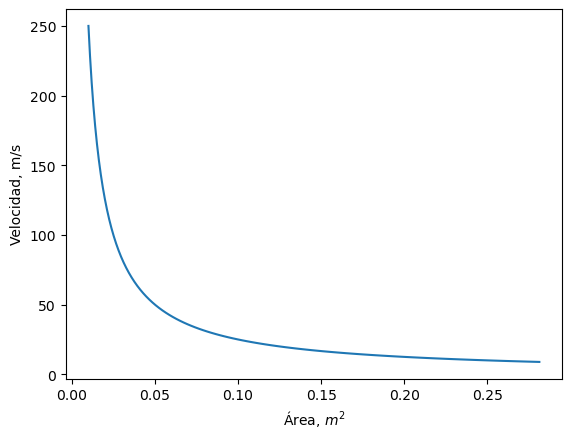

In [32]:
plt.plot(a*b, Q/(a*b))
plt.xlabel("Área, $m^2$")
plt.ylabel("Velocidad, m/s")
plt.show()

In [9]:
den_aire = 1.2 #kg/m^3
Ds = 0.75
NH = 16 * ((aa*bb)/Ds**2)

In [10]:
delta_P =  0.5* den_aire * vel_e**2 * NH

In [30]:
fig = go.Figure(data=[go.Surface(x=aa, y=bb, z=delta_P, colorscale='Viridis', showscale=False)])

fig.update_layout(title='Caida de presión, Pa', autosize=False,width=500, height=500,
                  margin=dict(l=40, r=45, b=65, t=90), xaxis=(dict(title="altura")))

fig.show()

In [44]:
len(np.unique(NH.flatten()))

9774

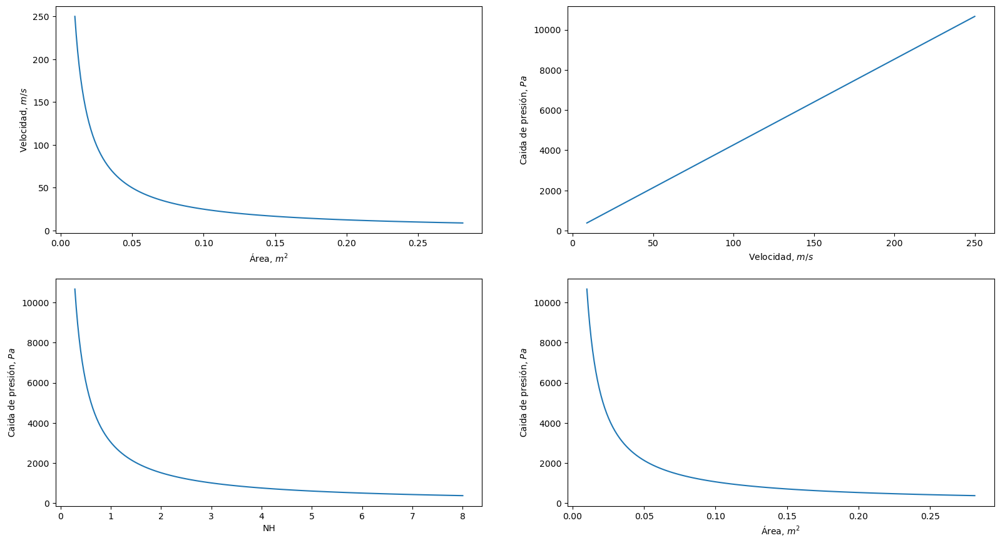

In [52]:
fig,((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(10,10),
                                         gridspec_kw=dict(left=0.3, right=1.8,bottom=0.1, top=0.9))
ax1.plot(a*b, Q/(a*b)) #Velocidad  Vs Area
ax2.plot( Q/(a*b),0.5*1.2*(16*a*b/Ds**2)*(Q/(a*b))**2) #Caida de presion Vs Velocidad
ax3.plot(16*a*b/Ds**2,0.5*1.2*(16*a*b/Ds**2)*(Q/(a*b))**2) #Caida de presion Vs Numero de cabezas
ax4.plot(a*b,0.5*1.2*(16*a*b/Ds**2)*(Q/(a*b))**2)#Caida de presion Vs Area de entrada

ax1.set_xlabel("Área, $m^2$")
ax2.set_xlabel("Velocidad, $m/s$")
ax3.set_xlabel("NH")
ax4.set_xlabel("Área, $m^2$")

ax1.set_ylabel("Velocidad, $m/s$")
ax2.set_ylabel("Caida de presión, $Pa$")
ax3.set_ylabel("Caida de presión, $Pa$")
ax4.set_ylabel("Caida de presión, $Pa$")

plt.show()

En las gráficas anteriores se observa como el área del ducto de entrada, la velocidad, el número de cabezas (relacionado con el ducto de finos, $D_s$) afectan la caída de la presión.

Al reducirse el área de entrada, la fuerza que ejerce el aire en ese punto incremeta la presión. Esa presión al pasar al área interna del ciclón presentará una mayor caida cuando la diferencia de diámetros a entrada y a la salida de los finos tiende a valores cercanos a cero.

## 2.  Fuerzas al interior del ciclón

Las fuerzas que se ejercen sobre las partículas al interior del ciclón son: la fuerza certifuga ($\vec{F}_{c}$), fuerza de empuje ($\vec{F}_{e}$) y fuerza de fricción ($\vec{F}_{D}$). La relación de estas tres fuerzas la podemos ver en la ecuación 3.

$
\vec{F}_{c} = \vec{F}_{e} + \vec{F}_{D}
\tag{3}
$

$
\vec{F}_{c} = \frac{\pi * d^{3} * \rho_{p}}{6} * \frac{\vec{V}_{\theta}^{2}}{R}
$

$
\vec{F}_{e} = \frac{\pi * d^{3} * \rho_{f}}{6} * \frac{\vec{V}_{\theta}^{2}}{R}
$

$
\vec{F}_{D} = 3* \pi * d * \mu_{f} * \vec{V}_{r}
$

$d$: diámetro de la partícula <br>
$\rho_{f}$:densidad del fluido <br>
$\rho_{p}$:densidad de la partícula <br>
$\mu$: viscosidad dinámica del fluido <br>
$R$: Radio del ciclón <br>
$\vec{V}_{\theta}$: velocidad tangencial<br>
$\vec{V}_{r}$: velocidad radial o angular

Al despejar todas las variables que intervienen en las tres fuerzas que se aplican sobre la partícula, obtenemos la ecuación 4.

$
d = \sqrt{\frac{18* \mu * R * \vec{V}_{r}}{\vec{V}_{\theta}^{2} * (\rho_{p}-\rho_{f})}}
\tag{4}
$

La velocidad tangencial la podemos obtener a través de su relación con la velocidad angular como (ec. 5):

$
\vec{V}_{\theta} = \vec{V}_{r} * R
\tag{5}
$

Mientras que **en este caso** la velocidad radial la podemos expresar en términos del caudal de entrada (ec. 6):

$
\vec{V}_{r} = \frac{Q}{2*\pi*R*h}
\tag{6}
$

Donde $h$ es la altura de la parte cilindrica del ciclón.

Al unificar los términos de las ecuaciones 5 y 6 en la ecuación 4 obtenemos (ec. 7):

$
d = \sqrt{\frac{36*\pi*\mu*h}{Q(\rho_{p}-\rho_{f})}}
\tag{7}
$

### Ejemplo:

Miremos un ejemplo gráfico con diferentes caudales y densidades y viscosidades del aire:

In [54]:
propiedadesAire = {"temperatura":[-30,-20,-10,0,10,20,30,40,50,60,70,80,90,100,200,300],
                  "densidad":[1.452,1.394,1.342,1.292,1.247,1.204,1.164,1.127,1.092,1.060,1.030,1.000,0.973,0.946,0.746,0.616],
                  "viscosidad":[1.56e-5,1.61e-5,1.67e-5,1.72e-5,1.76e-5,1.81e-5,1.86e-5,1.91e-5,1.95e-5,2e-5,2.05e-5,2.09e-5,2.13e-5,2.17e-5,2.57e-5,2.53e-5]}

propiedadesAire = pd.DataFrame(propiedadesAire)
propiedadesAire

#Temperatura en °C
#Densidad en kg/m3
#Viscosidad dinámica en pa*s

,temperatura,densidad,viscosidad
0,-30,1.452,0.000016
1,-20,1.394,0.000016
2,-10,1.342,0.000017
3,0,1.292,0.000017
4,10,1.247,0.000018
5,20,1.204,0.000018
6,30,1.164,0.000019
7,40,1.127,0.000019
8,50,1.092,0.000019
9,60,1.060,0.000020


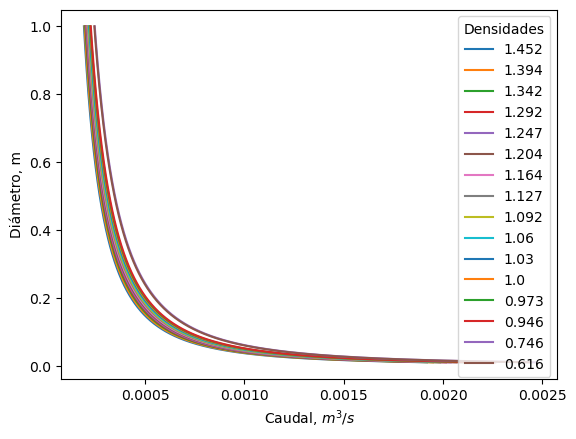

In [67]:
Q = np.linspace(0.01,1,1000) #Caudal en m3/s
h = 0.25 #m
denP = 1000 #kg/m3

for i in range(len(propiedadesAire)):
    d= np.sqrt((3*np.pi*propiedadesAire.iloc[i,2]*h)/(Q * (denP-propiedadesAire.iloc[i,1])))
    plt.plot(d,Q,label=propiedadesAire.iloc[i,1])
    plt.xlabel("Caudal, $m^3 / s$")
    plt.ylabel("Diámetro, m")
    plt.legend(title="Densidades")

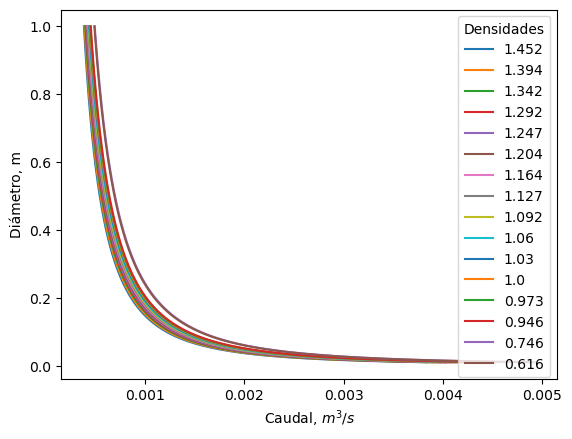

In [65]:
Q = np.linspace(0.01,1,1000) #Caudal en m3/s
h = 1 #m
denP = 1000 #kg/m3

for i in range(len(propiedadesAire)):
    d= np.sqrt((3*np.pi*propiedadesAire.iloc[i,2]*h)/(Q * (denP-propiedadesAire.iloc[i,1])))
    plt.plot(d,Q,label=propiedadesAire.iloc[i,1])
    plt.xlabel("Caudal, $m^3 / s$")
    plt.ylabel("Diámetro, m")
    plt.legend(title="Densidades")
    

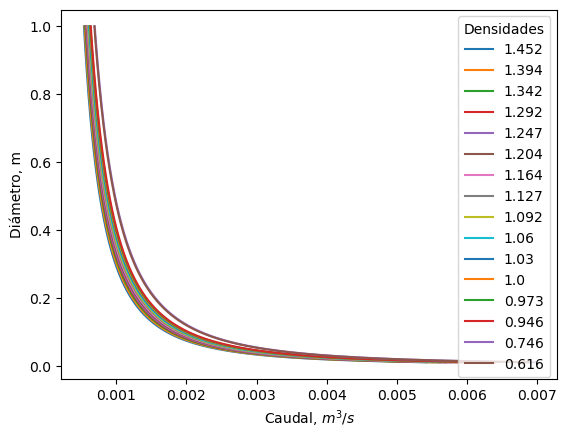

In [66]:
Q = np.linspace(0.01,1,1000) #Caudal en m3/s
h = 2 #m
denP = 1000 #kg/m3

for i in range(len(propiedadesAire)):
    d= np.sqrt((3*np.pi*propiedadesAire.iloc[i,2]*h)/(Q * (denP-propiedadesAire.iloc[i,1])))
    plt.plot(d,Q,label=propiedadesAire.iloc[i,1])
    plt.xlabel("Caudal, $m^3 / s$")
    plt.ylabel("Diámetro, m")
    plt.legend(title="Densidades")
    

In [78]:
def DiametroParticula(caudal,altura,densidadP):
    fig = go.Figure()
    for i in np.arange(len(propiedadesAire)):
        d= np.sqrt((3*np.pi*propiedadesAire.iloc[i,2]*altura)/(caudal * (densidadP-propiedadesAire.iloc[i,1])))   
        fig.add_trace(go.Scatter(x=d, y=caudal, mode='lines',name= propiedadesAire.iloc[i,1]))
        fig.update_layout(xaxis=(dict(tickformat=".6f",tickangle=90 ,title='$Caudal, m3/s$')),yaxis=(dict(tickformat=".1e",title='$Diámetro, m$')))
        fig.show()

In [81]:
DiametroParticula(np.linspace(0.001,0.5,1000), 0.15, 1000)

Ahora integremos dos nuevas ecuaciones:

$
Stk = \frac{d^{2}*\rho_{p}*\vec{V}}{18*\mu*D}
\tag{8}
$

$
E = \frac{\Delta P}{\rho_{f}*\vec{V}^{2}*0.5}
\tag{9}
$

Donde $\vec{V}$ es la velocidad del fluido en el ducto de entrada. $\vec{V}$ puede ser estimado como la relación entre el caudal y el área del ducto de entrada ($\vec{V} = \frac{Q}{A}$). $Stk$ y $E$ son los números de Euler y de Stokes, estos dos numeros se relacionan mediante la expresión $E = \sqrt{\frac{12}{Stk}}$

## Taller

Realice un análisis de las ecuaciones de Stokes y Euler con el diámetro de la partícula identificado en la ecuación 7.